In [ ]:
# CONTROLS
redo_data_load = False  # for redoing the initial data load
redo_feat_eng = False  # for adding new features
optimize_parameters = False  # for optimizing hyperparameters

0.1 Set-up: Packages and data

In [ ]:
from google.colab import drive
drive.mount('/gdrive')

Drive already mounted at /gdrive; to attempt to forcibly remount, call drive.mount("/gdrive", force_remount=True).


In [ ]:
# root_path = '/content/drive/My Drive/di-thesis/'
root_path = '/gdrive/My Drive/di-thesis/'

import pandas as pd
import numpy as np
import seaborn as sns
import holidays
import datetime
import lightgbm as lgbm

import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
if redo_data_load:
  # import using abspath
  import importlib.util
  !pip install OWSLib
  spec = importlib.util.spec_from_file_location("history_loader", root_path + "history_loader.py")
  history_loader = importlib.util.module_from_spec(spec)
  spec.loader.exec_module(history_loader)

In [ ]:
if redo_data_load:
  elec = pd.read_fwf(root_path+'sql-dump-elec-turku.rpt', skiprows=2)
  elec.columns = ['MeterID', 'Consumption', 'CalculationRuleConceptID', 'ConsumptionItemID', 'IsDeleted', 'ObjectID', 'Coefficient', 'MeterCoefficient', 'ReadingIntervalID', 'MeterPosition', 'MeterPosition2', 'ConsumptionWithCoef', 'Date', 'Time', 'Hour', 'cons']
  heat = pd.read_fwf(root_path+'sql-dump.rpt', skiprows=2)
  heat.columns = ['MeterID', 'Consumption', 'CalculationRuleConceptID', 'ConsumptionItemID', 'IsDeleted', 'ObjectID', 'Coefficient', 'MeterCoefficient', 'ReadingIntervalID', 'MeterPosition', 'MeterPosition2', 'ConsumptionWithCoef', 'Date', 'Time', 'Hour', 'cons']

0.2 Set-up: Subset Turku

In [ ]:
# add locations
locations = pd.read_csv(root_path + 'objectid-location.csv')
# code locations with integers
loc_coder = dict(zip(locations['LocationName'].dropna().unique(), range(len(locations['LocationName'].dropna().unique()))))
# assign nans to -1
loc_coder[float('Nan')] = -1
locations['LocCode'] = locations['LocationName'].map(loc_coder)
# objectIDs to location codes
obID_placer = dict(zip(locations['ObjectID'], locations['LocCode']))

In [ ]:
if redo_data_load:
  heat['LocCode'] = heat['ObjectID'].map(obID_placer)
  # drop nans
  heat = heat.loc[heat['LocCode'] > -1]

  elec['LocCode'] = elec['ObjectID'].map(obID_placer)
  # drop nans
  elec = elec.loc[elec['LocCode'] > -1]

In [ ]:
if redo_data_load: heat.groupby('LocCode').count().sort_values('MeterID', ascending=False)

In [ ]:
 if redo_data_load:
  # take only Turku
  heat = heat.loc[(heat['LocCode'] == loc_coder['Turku'])]

  # elec is a Trúrku subset already

0.3 Set-up: Drop irrelevant columns

In [ ]:
if redo_data_load:
  heat = heat[['MeterID', 'ObjectID', 'Date', 'Time', 'cons']]
  elec = elec[['MeterID', 'ObjectID', 'Date', 'Time', 'cons']]

In [ ]:
# bypass the work above
if redo_data_load:
  heat.to_pickle(root_path+'heat.pkl')
  elec.to_pickle(root_path+'elec.pkl')
else:
  heat = pd.read_pickle(root_path+'heat.pkl')
  elec = pd.read_pickle(root_path+'elec.pkl')

0.4 Set-up: Parse to datetime

In [ ]:
# parse datetime values
heat['Time'] = heat['Date'] + " " + heat['Time']
heat['Time'] = pd.to_datetime(heat['Time'])
heat = heat.drop(columns=['Date'])

elec['Time'] = elec['Date'] + " " + elec['Time']
elec['Time'] = pd.to_datetime(elec['Time'])
elec = elec.drop(columns=['Date'])

**1 Initial data diagnostics**

1.1 Consumption data errors

In [ ]:
print('Number of rows in the datasets: Heat {}, Electricity {}'.format(heat.shape[0], elec.shape[0]))

Number of rows in the datasets: Heat 727623, Electricity 993439


In [ ]:
dupls_heat = heat[['MeterID', 'Time']].duplicated().sum() / heat.shape[0]
print('Share of heat data duplicated between buildings {:.1%}'.format(dupls_heat))
dupls_elec = elec[['MeterID', 'Time']].duplicated().sum() / elec.shape[0]
print('Share of electricity data duplicated between buildings {:.1%}'.format(dupls_elec))

# drop meters duplicated between multiple buildings
heat = heat.drop_duplicates(['MeterID', 'Time'])
elec = elec.drop_duplicates(['MeterID', 'Time'])

Share of heat data duplicated between buildings 47.0%
Share of electricity data duplicated between buildings 42.6%


In [ ]:
print('Share of rows having some NaN valued columns in heat is {:.2%}'.format(sum(heat.isna().sum(axis=1) > 0) / heat.shape[0]))
print('Share of rows having some NaN valued columns in electricity is {:.2%}'.format(sum(elec.isna().sum(axis=1) > 0) / elec.shape[0]))

Share of rows having some NaN valued columns in heat is 0.00%
Share of rows having some NaN valued columns in electricity is 0.00%


In [ ]:
# check that we have expected number of rows per meter
days = heat.groupby('MeterID').max()['Time'] - heat.groupby('MeterID').min()['Time']
days = days.dt.days * 24

n_rows = heat.groupby('MeterID').count()['Time']

n_rows / days

MeterID
13307    1.002255
13309    1.002255
13311    1.002396
13315    1.002255
13319    1.002396
13321    1.002396
13323    1.002255
13335    1.002255
13337    1.002255
13339    1.002255
13341    1.002255
13343    1.002255
13345    1.002396
13347    1.002255
13351    1.002102
14807    1.001315
14818    1.001315
14832    1.001315
14852    1.001315
14951    1.000440
15003    1.001315
15004    1.001315
15017    1.001315
15023    1.001315
15057    1.001315
15069    1.001315
15072    1.002404
15305    1.001315
15324    1.001315
Name: Time, dtype: float64

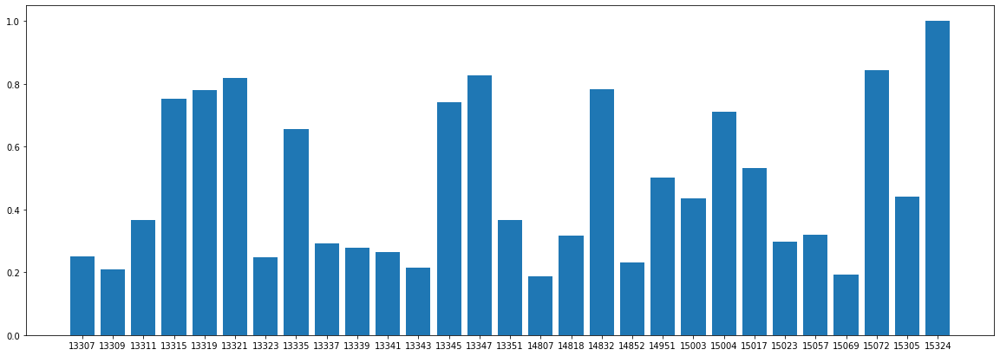

In [ ]:
# number of zero differences per meter
test = heat.set_index('Time').pivot(columns='MeterID', values='cons').dropna()
plt.figure(figsize=(20,7));
plt.bar((test.diff() == 0).mean().index, (test.diff() == 0).mean());

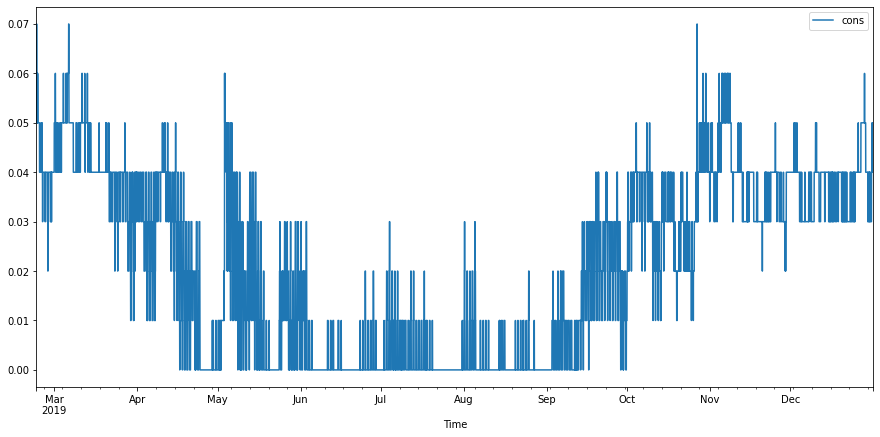

In [ ]:
# visual estimation of data granularity
heat.loc[heat['MeterID'] == heat['MeterID'].unique()[-3]].plot('Time','cons', figsize=(15,7));

In [ ]:
# remove meters with more than half differences zero in test period
period = heat.set_index('Time').pivot(columns='MeterID', values='cons').dropna()
null_diff = (period.diff() == 0).sum() / period.shape[0]
heat = heat.loc[heat['MeterID'].isin(null_diff.loc[null_diff < 0.5].index.values)]

# same for electricity
period = elec.set_index('Time').pivot(columns='MeterID', values='cons').dropna()
null_diff = (period.diff() == 0).sum() / period.shape[0]
elec = elec.loc[elec['MeterID'].isin(null_diff.loc[null_diff < 0.5].index.values)]

print('Due to operation heat dataset reduced from {} to {} rows. \nElectricity from {} to {}.'.format(h_len, heat.shape[0], e_len, elec.shape[0]))

Due to operation heat dataset reduced from 385342 to 232303 rows. 
Electricity from 570367 to 561608.


1.2 Consumption data properties

Testing heat for outliers.
First plot indicates great variance.

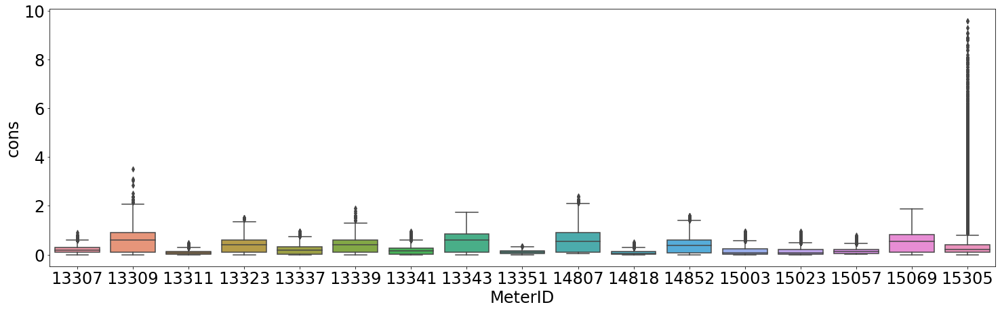

In [ ]:
import matplotlib
font = {'size':24}
matplotlib.rc('font', **font)

fig, ax = plt.subplots(figsize=(25,7))
sns.boxplot('MeterID', 'cons', data=heat, ax=ax);

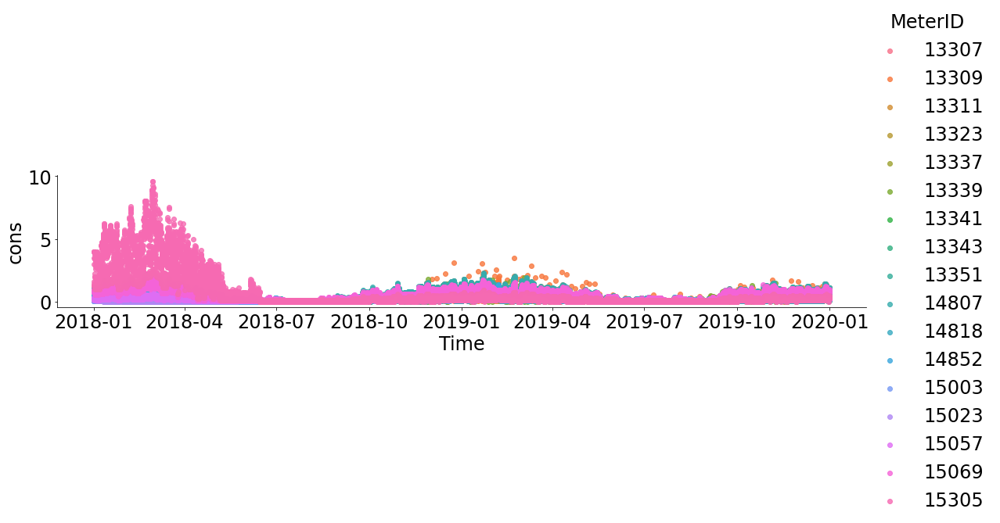

In [ ]:
sns.lmplot('Time', 'cons', data=heat, hue='MeterID', fit_reg=False, height=4, aspect=4)

Removing only the meter with the largest values reduces variance in the winter 2018 quite a lot

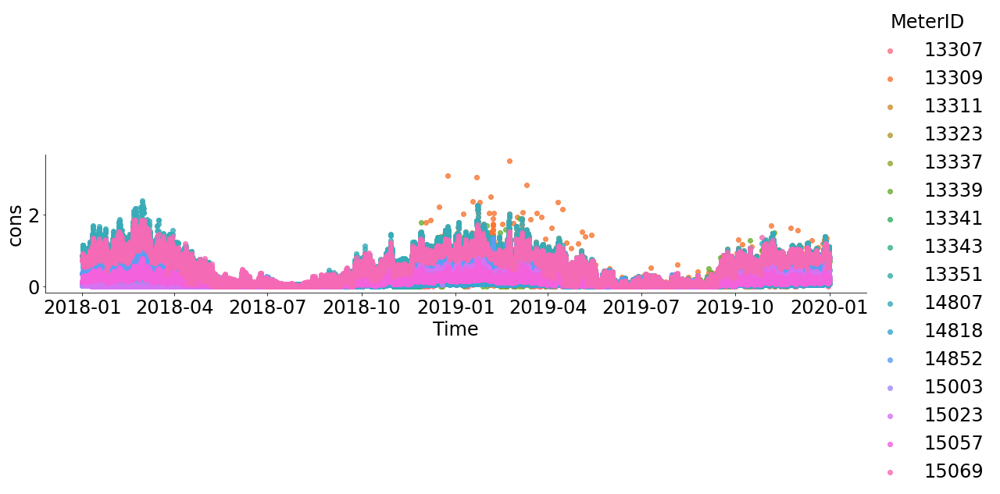

In [ ]:
max_id = heat.loc[heat['cons'] == max(heat['cons'])]['MeterID'].values[0]
sns.lmplot('Time', 'cons', data=heat.loc[heat['MeterID'] != max_id], hue='MeterID', fit_reg=False, height=4, aspect=4)

Plotting only the meter with the largest values we that the peaks in 2018 are strangely over 10-fold larger than those in 2019 or 2020. This abnormality might be regarded as an outlier that could be removed from the data. Considering the weather being similarly cold in 2018 and 2019 (weather data is analysed later in this notebooks), the meter discussed is removed as an outlier.

MeterID: 15305


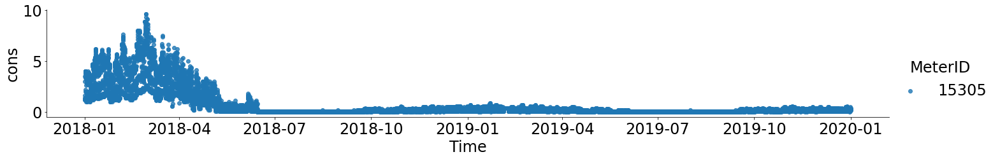

In [ ]:
print('MeterID:', max_id)
sns.lmplot('Time', 'cons', data=heat.loc[heat['MeterID'] == max_id], hue='MeterID', fit_reg=False, height=4, aspect=5)

In [ ]:
# remove the meter with outliers
heat = heat.loc[heat['MeterID'] != max_id]

Different time spans can also be examined closer

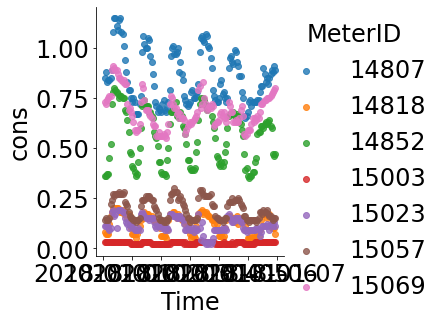

In [ ]:
#heat.loc[heat['Time']<datetime.datetime(2018,1,7)].plot.scatter('Time','cons')
sns.lmplot('Time', 'cons', data=heat.loc[heat['Time']<datetime.datetime(2018,1,7)], hue='MeterID', fit_reg=False)

Assessment of the distribution of mean values between meters to assess disparity in consumption levels

In [ ]:
heat.groupby('MeterID').mean().describe()['cons']

count    16.000000
mean      0.280798
std       0.186842
min       0.073942
25%       0.130940
50%       0.184426
75%       0.423753
max       0.564173
Name: cons, dtype: float64

In [ ]:
heat.groupby('MeterID').std().describe()['cons']

count    16.000000
mean      0.226297
std       0.134454
min       0.068992
25%       0.131714
50%       0.157704
75%       0.327834
max       0.439180
Name: cons, dtype: float64

Electricity seems less seasonal

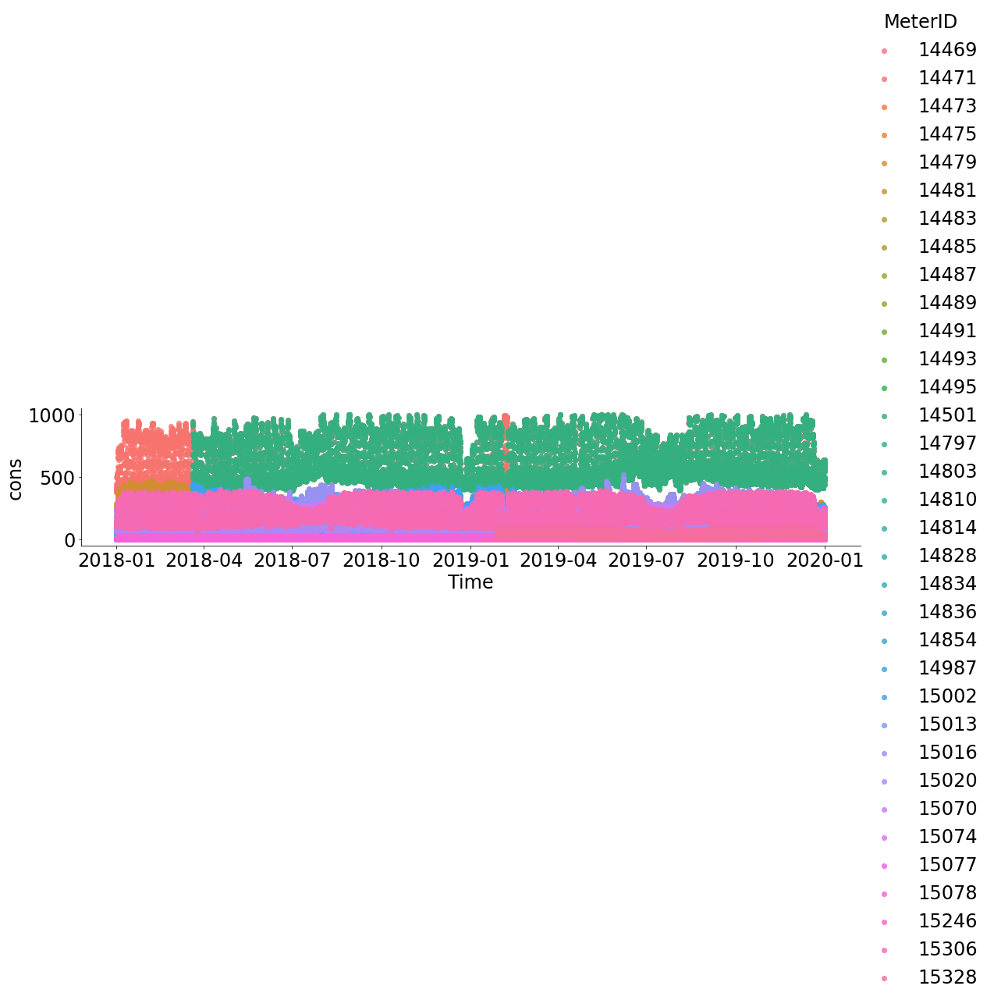

In [ ]:
sns.lmplot('Time', 'cons', data=elec, hue='MeterID', fit_reg=False, height=4, aspect=4)

In [ ]:
import plotly.express as px
fig = px.line(elec, x="Time", y="cons", color='MeterID')
fig.show()

However, there are actually bigger heavy hitters in electricity than in heat. Considering the domain of energy consumption, however, the max value here cannot be discarded as an outlier.

In [ ]:
elec.groupby('MeterID').mean().describe()['cons']

count     34.000000
mean     117.800202
std      135.411028
min        1.468218
25%       12.831918
50%       82.634822
75%      188.519038
max      569.189612
Name: cons, dtype: float64

[]

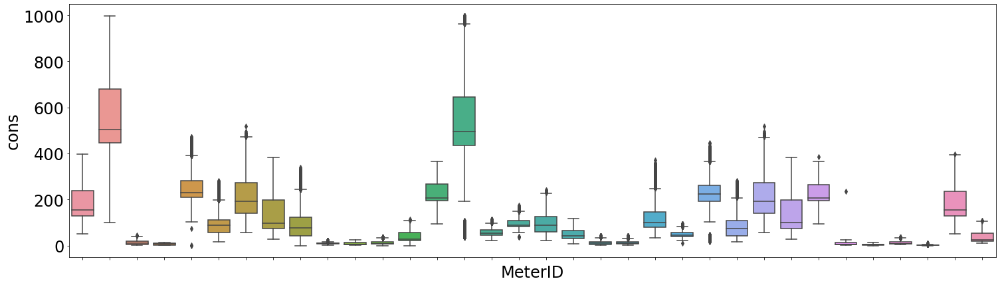

In [ ]:
import matplotlib
font = {'size':24}
matplotlib.rc('font', **font)

fig, ax = plt.subplots(figsize=(25,7))
sns.boxplot('MeterID', 'cons', data=elec, ax=ax)
ax.set_xticklabels('')

Basic descriptive statistics of the consumption data

In [ ]:
heat['cons'].describe()

count    214784.000000
mean          0.280072
std           0.320340
min           0.000000
25%           0.040000
50%           0.150000
75%           0.410000
max           3.500000
Name: cons, dtype: float64

In [ ]:
elec['cons'].describe()

count    561608.000000
mean        123.063157
std         151.787068
min           0.000000
25%          14.000000
50%          70.000000
75%         187.000000
max         999.000000
Name: cons, dtype: float64

1.3 Weather data errors

In [ ]:
# load from FIM
#loc = ['Turku']
#weather = history_loader.load_history((2018, 1), (2019, 12), loc)
#weather.to_pickle(root_path+'turku-weather-hist.pickle')

# load from local
weather = pd.read_pickle(root_path+'turku-weather-hist.pickle')
weather['Place'] = weather['Place'].map(loc_coder)

In [ ]:
print('Share of rows having some NaN valued columns in weather is {:.2%}'.format(sum(weather.isna().sum(axis=1) > 0) / weather.shape[0]))
weather.isna().any()

Share of rows having some NaN valued columns in weather is 0.50%


Time               False
Place              False
Temperature         True
TotalCloudCover     True
WindDirection       True
WindSpeedMS         True
Humidity            True
Precipitation1h     True
dtype: bool

In [ ]:
weather.nunique()

Time               17520
Place                  1
Temperature          524
TotalCloudCover       10
WindDirection        361
WindSpeedMS          103
Humidity              82
Precipitation1h       61
dtype: int64

1.4 Weather data properties

In [ ]:
weather.describe()

,Place,Temperature,TotalCloudCover,WindDirection,WindSpeedMS,Humidity,Precipitation1h
count,17520.0,17517.000000,17517.000000,17472.000000,17447.000000,17514.000000,17504.000000
mean,1.0,7.357538,4.651824,170.892571,2.950123,78.279205,0.068864
std,0.0,9.416850,3.534173,105.486227,1.666932,19.192523,0.389041
min,1.0,-21.700000,0.000000,0.000000,0.000000,19.000000,0.000000
25%,1.0,0.600000,0.000000,89.000000,1.800000,66.000000,0.000000
50%,1.0,6.500000,7.000000,175.000000,2.800000,84.000000,0.000000
75%,1.0,14.800000,8.000000,251.000000,4.000000,94.000000,0.000000
max,1.0,33.200000,9.000000,360.000000,11.500000,100.000000,18.200000


In [ ]:
# prepare mapping for direction to itself except 8 to 0, cf. 0 == 360 deg. 
binner = dict(zip(range(8), range(8)))
binner[8] = 0

# categorise wind direction to 45 degree bins
weather['WindDirection'] = (weather['WindDirection']/45).round().map(binner)
weather['WindDirection'] = weather['WindDirection'].astype('category')

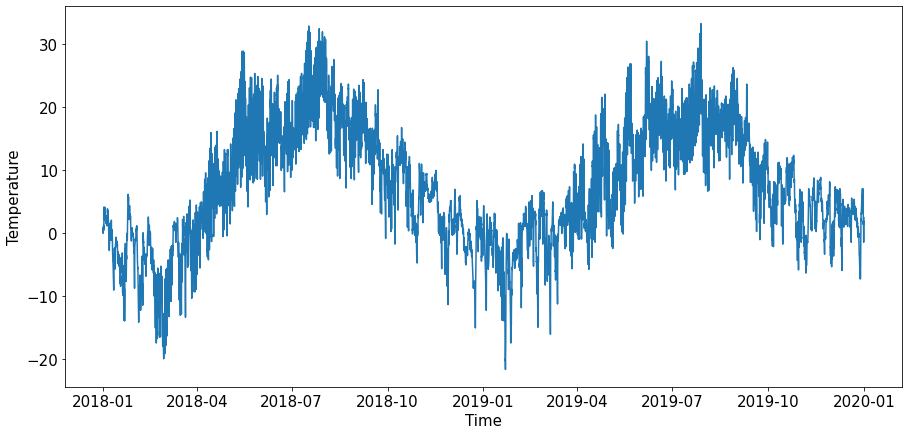

In [ ]:
import matplotlib
font = {'size':15}
matplotlib.rc('font', **font)

fig, ax = plt.subplots(figsize=(15,7))
ax = sns.lineplot(weather['Time'], weather['Temperature'])

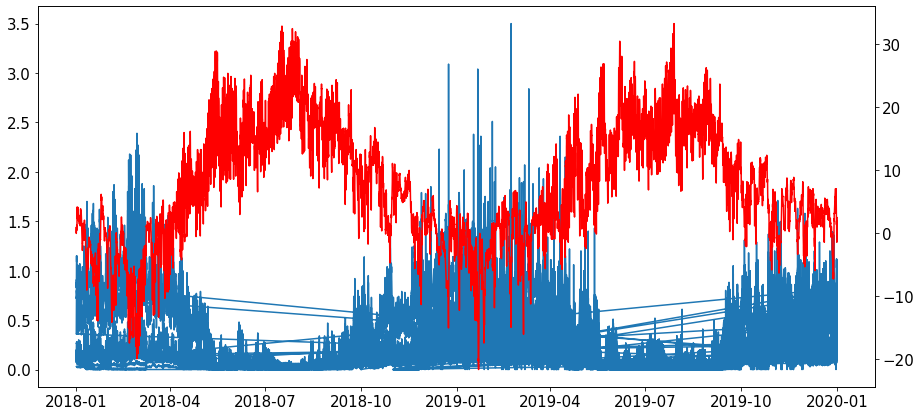

In [ ]:
fig, ax = plt.subplots(figsize=(15,7))
ax.plot(heat['Time'], heat['cons'])
ax2 = ax.twinx()
ax2.plot(weather['Time'], weather['Temperature'], 'r');

In [ ]:
weather['Time'].min()

Timestamp('2018-01-01 00:00:00')

In [ ]:
elec.groupby('Time').mean().shape

(17520, 2)

In [ ]:
# set correct datatypes
heat = heat.astype({'MeterID':'category', 'ObjectID':'category'})
elec = elec.astype({'MeterID':'category', 'ObjectID':'category'})

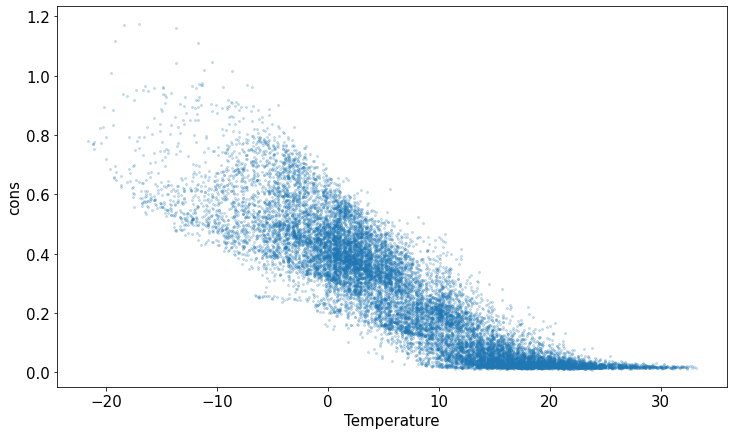

In [ ]:
fig, ax = plt.subplots(figsize=(12,7))
ax.scatter(weather['Temperature'].iloc[1:], heat.groupby('Time').mean(), s=4, alpha=0.2);
ax.set_xlabel('Temperature');
ax.set_ylabel('cons');

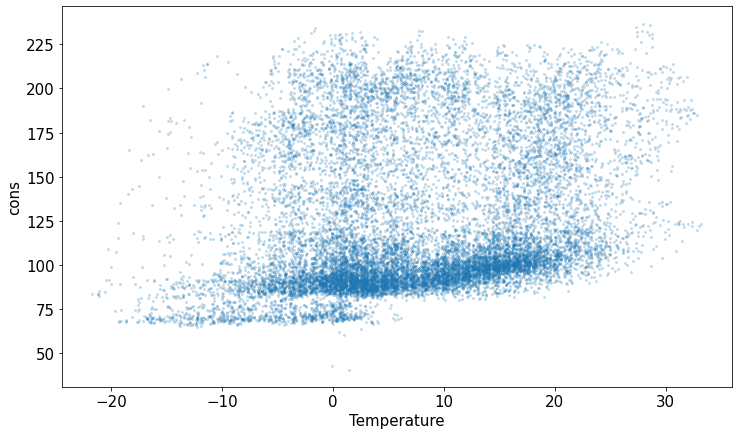

In [ ]:
fig, ax = plt.subplots(figsize=(12,7))
ax.scatter(weather['Temperature'], elec.groupby('Time').mean(), s=4, alpha=0.2)
ax.set_xlabel('Temperature');
ax.set_ylabel('cons');

In [ ]:
# fill nans with last valid value
# weather = weather.fillna(method='ffill')
# weather.isna().any()

**2 Feature engineering**

2.1 Consumption data

In [ ]:
hdays = holidays.FI()

heat['Hour'] = heat['Time'].dt.hour
heat['Weekday'] = heat['Time'].dt.weekday
heat['Holiday'] = heat['Time'].apply(lambda x: x in hdays)

elec['Hour'] = elec['Time'].dt.hour
elec['Weekday'] = elec['Time'].dt.weekday
elec['Holiday'] = elec['Time'].apply(lambda x: x in hdays)

In [ ]:
# set index
heat = heat.set_index('Time')
elec = elec.set_index('Time')

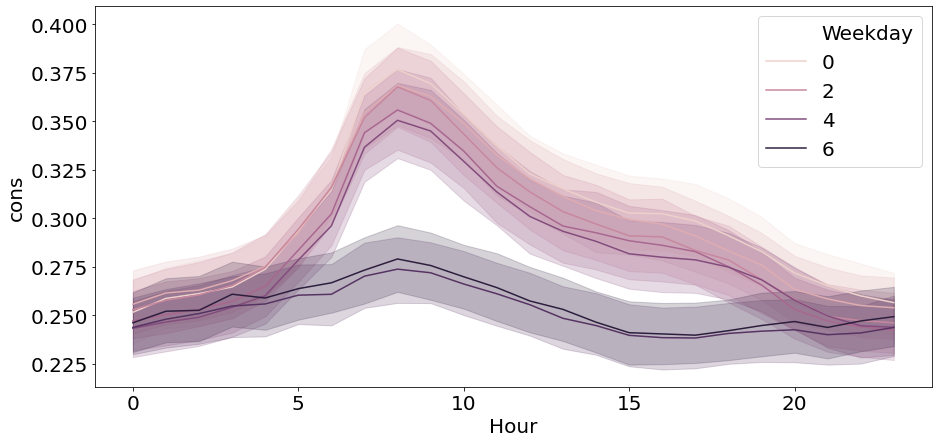

In [ ]:
import matplotlib
font = {'size':20}
matplotlib.rc('font', **font)

plt.figure(figsize=(15,7))
sns.lineplot(data=heat, y='cons', x='Hour', hue='Weekday');

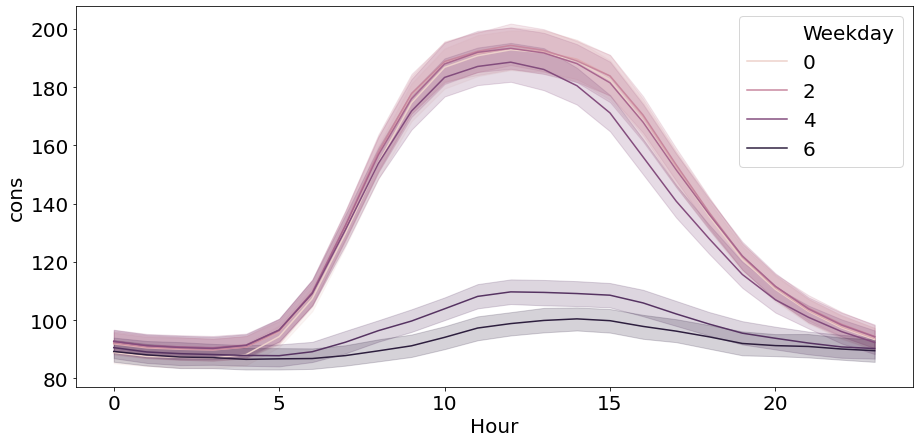

In [ ]:
plt.figure(figsize=(15,7))
sns.lineplot(data=elec, y='cons', x='Hour', hue='Weekday');

In [ ]:
# time index needs to be monotonic
heat = heat.sort_index()
elec = elec.sort_index()

In [ ]:
if redo_feat_eng:
  PRED_HORIZON = 24  # hours

  temp = []

  for i, met in enumerate(heat['MeterID'].unique()):

    df = heat.loc[heat['MeterID'] == met]

    # fill missing hours
    df = df.fillna(method='ffill')

    for lag in range(PRED_HORIZON+1,28):
        df[f'lag_{lag}H'] = df['cons'].shift(freq=f'{lag}H')
    for lag in [2,7,14]:
        df[f'lag_{lag}D'] = df['cons'].shift(freq=f'{lag}D')
    for rolling in [1,3,7,14,28]:
        df[f'rolling_{rolling}D'] = df['cons'].shift(freq=f'{PRED_HORIZON}H').rolling(f'{rolling}D').mean()
    df['day_off'] = (df['Holiday'] == 1) | (df['Weekday'] >= 5)
    df['day_off_MA'] = df['day_off'].rolling(24 * 4, center=True).mean()
    df = df.drop(columns=['Weekday', 'Holiday'])

    temp.append(df)

  heat = pd.concat(temp).dropna()

In [ ]:
if redo_feat_eng:
  PRED_HORIZON = 24  # hours

  temp = []

  for i, met in enumerate(elec['MeterID'].unique()):

    df = elec.loc[elec['MeterID'] == met]
    # fill missing hours
    df = df.fillna(method='ffill')

    for lag in range(PRED_HORIZON+1,28):
        df[f'lag_{lag}H'] = df['cons'].shift(freq=f'{lag}H')
    for lag in [2,7,14]:
        df[f'lag_{lag}D'] = df['cons'].shift(freq=f'{lag}D')
    for rolling in [1,3,7,14,28]:
        df[f'rolling_{rolling}D'] = df['cons'].shift(freq=f'{PRED_HORIZON}H').rolling(f'{rolling}D').mean()
    df['day_off'] = (df['Holiday'] == 1) | (df['Weekday'] >= 5)
    df['day_off_MA'] = df['day_off'].rolling(24 * 4, center=True).mean()
    df = df.drop(columns=['Weekday', 'Holiday'])

    temp.append(df)

  elec = pd.concat(temp).dropna()


2.2 Weather

In [ ]:
if redo_feat_eng:
  weather = weather.set_index('Time')
  for lag in range(1,6):
    weather[f'temp_lag_{lag}H'] = weather['Temperature'].shift(freq=f'{lag}H')

Saving for later use

In [ ]:
if redo_feat_eng:
  # merge weather data with consumption
  heat = heat.merge(weather, left_on=['Time'], right_on=['Time'])
  heat = heat.drop(columns='Place')

  elec = elec.merge(weather, left_on=['Time'], right_on=['Time'])
  elec = elec.drop(columns='Place')

In [ ]:
if redo_feat_eng:
  # indicate categorical features
  heat = heat.astype({'Hour':'category', 'day_off':'category'})
  elec = elec.astype({'Hour':'category', 'day_off':'category'})

**3 Modelling**

In [ ]:
if redo_feat_eng:
  heat.to_pickle(root_path+'feat_eng_heat.pkl')
  elec.to_pickle(root_path+'feat_eng_elec.pkl')
  weather.to_pickle(root_path+'feat_eng_weather.pkl')

# heat and elec time series with lag and weather features
else:
  heat = pd.read_pickle(root_path+'feat_eng_heat.pkl')
  elec = pd.read_pickle(root_path+'feat_eng_elec.pkl')
  # weather = pd.read_pickle(root_path+'feat_eng_weather.pkl')

In [ ]:
# coefficient of variance root mean squared error
def CV_RMSE(y_hat, y):
  return np.sqrt(np.mean((y_hat - y)**2))/np.mean(y)

In [ ]:
from sklearn.metrics import mean_squared_error
def CV_RMSE2(y_hat, y):
  return mean_squared_error(y, y_hat, squared=False)/np.mean(y)

def CV_MSE(y_hat, y):
  return mean_squared_error(y, y_hat, squared=True)/np.mean(y)**2

3.1 Heat: Hyperparameter tuning

In [ ]:
if optimize_parameters: 
  # hyperparameter tuning with optuna
  % pip install optuna 

In [ ]:
# training-testing split
split = 0.8 
heat_train = heat.iloc[:int(len(heat) * split),:]
heat_test = heat.iloc[int(len(heat) * split):,:]

In [ ]:
%%time
if optimize_parameters:
  import optuna
  from sklearn.metrics import mean_squared_error
  from sklearn.model_selection import TimeSeriesSplit


  def objective(trial):

    parameters = {
        'application': 'regression',
        'objective': 'rmse',
        'metric': 'rmse',
        'boosting': 'gbdt',
        'num_leaves': trial.suggest_int('num_leaves', 2, 500),
        # 'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0),
        # 'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0),
        # 'bagging_freq': trial.suggest_int('bagging_freq', 1, 50),
        'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1)
        # 'lambda_l1': trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
        # 'lambda_l2': trial.suggest_loguniform('lambda_l2', 1e-8, 10.0)
    }

    heat_errors = []

    # k-fold training and evaluation
    for split in TimeSeriesSplit().split(heat_train):

      # train-test split
      X = heat_train.iloc[split[0]].drop(columns=['ObjectID', 'MeterID', 'cons'])
      y = heat_train.iloc[split[0]]['cons']
      train_data = lgbm.Dataset(X, y)

      # training
      heat_booster = lgbm.train(parameters, train_data,
                          #valid_sets=test_data,
                          num_boost_round=1000,
                          #early_stopping_rounds=100
                          )
      
      # test data
      X = heat_train.iloc[split[1]].drop(columns=['ObjectID', 'MeterID', 'cons'])
      # predicted values
      y_hat = heat_booster.predict(X)

      # test error
      y = heat_train.iloc[split[1]]['cons']  # correct consumption values
      heat_errors.append(CV_RMSE(y_hat, y))
      
    # return error to minimise
    return np.mean(heat_errors)

  study = optuna.create_study(direction='minimize')
  study.optimize(objective, n_trials=30)


CPU times: user 4 µs, sys: 0 ns, total: 4 µs
Wall time: 7.15 µs


3.2 Heat: Model training

In [ ]:
from sklearn.model_selection import TimeSeriesSplit
import logging

# logger = logging.getLogger('heat_logger')
# logger.setLevel(logging.INFO)
# handler = logging.FileHandler(root_path+'log.txt')
# logger.addHandler(handler)
# logging.info('Test: Log starts')
# logging.basicConfig(filename=root_path+'vanilla_log.txt', level=logging.INFO)
# logging.info('Test: Log starts')

# model specification
parameters = {
    'verbose':1,
    'is_training_metric': True,  # output metric over train set
    'application': 'regression',
    'objective': 'rmse',
    'metric': 'rmse',
    'boosting': 'gbdt',
    #'bagging_fraction': 0.92,
    #'bagging_freq': 35,
    #'feature_fraction': 0.67,
    'learning_rate': 0.1, # 0.018,  # 0.05  #NEW: 0.01
    'num_leaves': 242 # 204  # 220  # 380
}

# prepare train data
X = heat_train.drop(columns=['ObjectID', 'MeterID', 'cons'])
y = heat_train['cons']
train_data = lgbm.Dataset(X, y)

# training
heat_booster = lgbm.train(parameters, train_data,
                    #valid_sets=test_data,
                    num_boost_round=1000,
                    #early_stopping_rounds=100
                    )


3.3 Heat: Model evaluation

In [ ]:
from sklearn.metrics import r2_score


# total error over entire test set
all_errors = pd.DataFrame()
heat_test_X = heat_test.drop(columns=['ObjectID', 'MeterID', 'cons'])
y = heat_test['cons']
y_hat = heat_booster.predict(heat_test_X)
all_errors['total_CVRMSE'] = CV_RMSE(y_hat, y)
all_errors['total_r2'] = r2_score(y, y_hat)
all_errors['CV_RMSE2'] = CV_RMSE2(y_hat, y)
all_errors['CV_MSE'] = CV_MSE(y_hat, y)
heat_residuals = y - y_hat

print('Total RMS error over test set is {:.2%}'.format(all_errors['total_CVRMSE']))
print('Total MS error over test set is {:.2%}'.format(all_errors['CV_MSE']))
print('R2 goodness of fit over test set is {:.2%}'.format(all_errors['total_r2']))

Total RMS error over test set is 22.86%
Total MS error over test set is 5.22%
R2 goodness of fit over test set is 90.93%


Benchmark: Regression model

In [ ]:
import statsmodels.api as sm

# nulls (in temperature) need to be cleaned up for linear regression
X = heat_train[['lag_25H', 'Temperature']].fillna(method='ffill').to_numpy()
X = sm.add_constant(X)
y = heat_train['cons'].to_numpy()

# model creation and fitting
heat_reg = sm.OLS(y, X)
heat_reg = heat_reg.fit()  # the trained model instance

heat_reg.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.907
Model:                            OLS   Adj. R-squared:                  0.907
Method:                 Least Squares   F-statistic:                 8.111e+05
Date:                Tue, 08 Sep 2020   Prob (F-statistic):               0.00
Time:                        14:39:52   Log-Likelihood:             1.4732e+05
No. Observations:              166924   AIC:                        -2.946e+05
Df Residuals:                  166921   BIC:                        -2.946e+05
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0550      0.000    112.867      0.000       0.054       0.056
x1             0.8898      0.001    976.697      0.000       0.888       0.892
x2            -0.0034   3.05e-05   -111.674      0.000      -0.003      -0.003
==============================================================================
Omnibus:                    61806.380   Durbin-Watson:                   1.014
Prob(Omnibus):                  0.000   Jarque-Bera (JB):          3289185.734
Skew:                           1.008   Prob(JB):                         0.00
Kurtosis:                      24.653   Cond. No.                         50.8
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [ ]:
X = heat_test[['lag_25H', 'Temperature']].fillna(method='ffill').to_numpy()
X = sm.add_constant(X)
y = heat_test['cons']

bench_y_hat = heat_reg.predict(X)

print('Total error over test set is {:.2%}'.format(CV_RMSE(bench_y_hat, y)))
print('R2 goodness of fit over test set is {:.2%}'.format(r2_score(y, bench_y_hat)))

Total error over test set is 28.41%
R2 goodness of fit over test set is 86.00%


[Text(0, 0.5, 'predicted')]

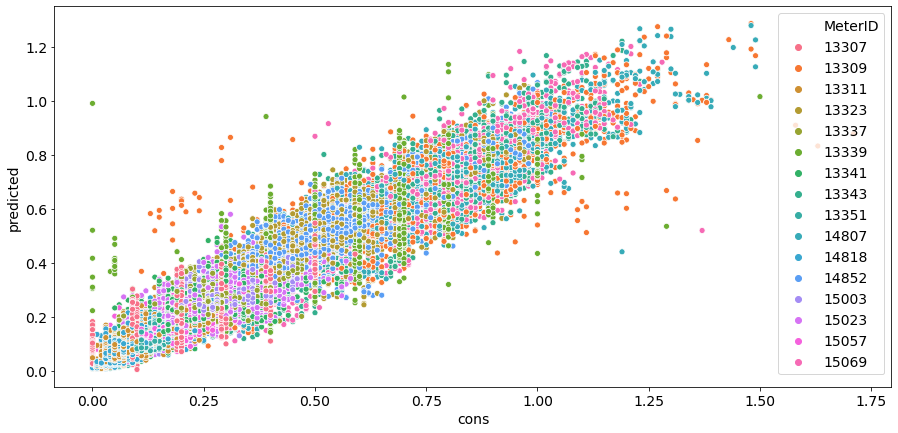

In [ ]:
font = {'size':14}
matplotlib.rc('font', **font)
plt.figure(figsize=(15,7))
pic = sns.scatterplot(y, y_hat, heat_test['MeterID'])
pic.set(ylabel="predicted")

[(0.001, 1.795)]

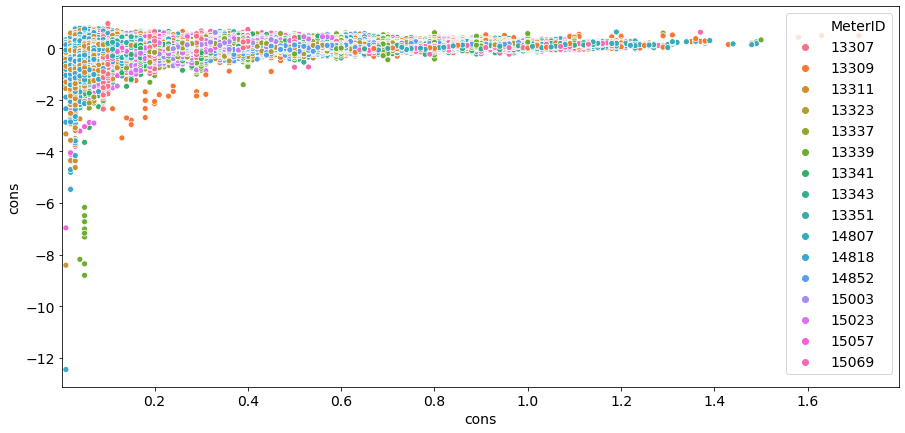

In [ ]:
plt.figure(figsize=(15,7))
pic = sns.scatterplot(y, heat_residuals/y, heat_test['MeterID'])
pic.set(xlim=(0.001, None))

In [ ]:
# mean of residuals is close to 0 which is good
heat_residuals.describe() 

count    41732.000000
mean         0.025548
std          0.078986
min         -0.990369
25%         -0.020536
50%          0.013192
75%          0.062800
max          0.850568
Name: cons, dtype: float64

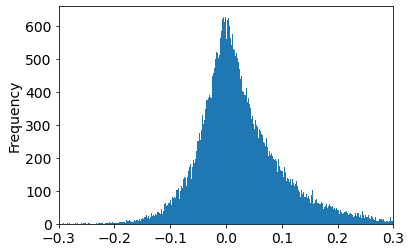

In [ ]:
heat_residuals.plot.hist(bins=1000);
plt.xlim((-0.3, 0.3));

In [ ]:
import scipy
print(scipy.stats.normaltest(heat_residuals))
print(scipy.stats.shapiro(heat_residuals))

NormaltestResult(statistic=7497.104842823686, pvalue=0.0)
(0.9430391192436218, 0.0)


p-value may not be accurate for N > 5000.


In [ ]:
print(heat_residuals.shape)
heat_residuals.index.unique().shape

(41732,)


(2609,)

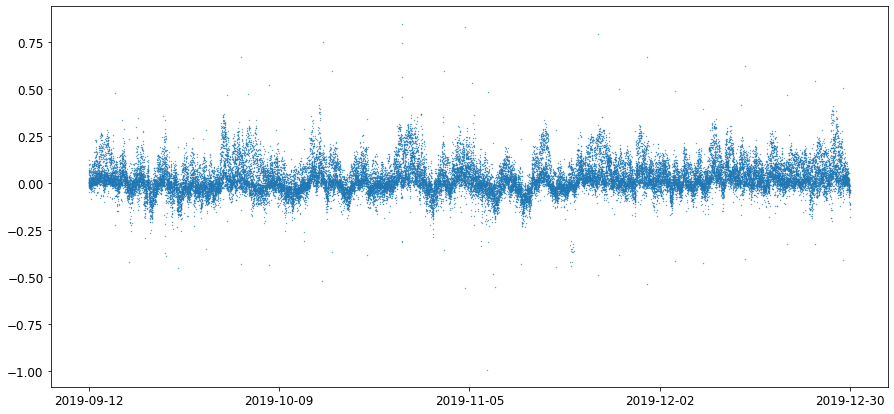

In [ ]:
font = {'size':12}
matplotlib.rc('font', **font)

plt.figure(figsize=(15, 7));
plt.scatter(heat_residuals.index, heat_residuals, s=0.1);

# ticks 
res_len = heat_residuals.shape[0]
n_ticks = 4
tick_places = [heat_residuals.index[i] for i in range(0, res_len, int(res_len/n_ticks)+1)]
tick_places.append(heat_residuals.index[-1])
tick_labels = [heat_residuals.index[i].date() for i in range(0, res_len, int(res_len/n_ticks)+1)]
tick_labels.append(heat_residuals.index[-1].date())
plt.xticks(tick_places, tick_labels);


In [ ]:
# largest errors
heat_residuals.nlargest(25)

Time
2019-10-27 03:00:00    0.850568
2019-11-05 03:00:00    0.832782
2019-11-24 03:00:00    0.797563
2019-10-15 18:00:00    0.755065
2019-10-27 03:00:00    0.749463
2019-10-04 03:00:00    0.673829
2019-12-01 03:00:00    0.670510
2019-12-15 03:00:00    0.622645
2019-10-17 03:00:00    0.598394
2019-11-02 03:00:00    0.598230
2019-10-27 03:00:00    0.565586
2019-12-25 03:00:00    0.544360
2019-11-06 03:00:00    0.533786
2019-10-08 03:00:00    0.521762
2019-12-29 03:00:00    0.506969
2019-11-27 03:00:00    0.503050
2019-12-05 03:00:00    0.493714
2019-11-08 08:00:00    0.484688
2019-09-16 03:00:00    0.480457
2019-10-05 03:00:00    0.473998
2019-12-21 03:00:00    0.472922
2019-10-02 03:00:00    0.472874
2019-10-27 03:00:00    0.460187
2019-10-15 06:00:00    0.418995
2019-12-14 13:00:00    0.415814
Name: cons, dtype: float64

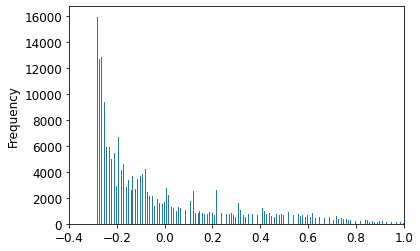

In [ ]:
# residuals from mean
(heat['cons']-np.mean(heat['cons'])).plot.hist(bins=1000)
plt.xlim((-0.4, 1));

In [ ]:
#heat_booster.save_model(root_path+'best_heat_booster.txt')

Plot a few meters to assess fit

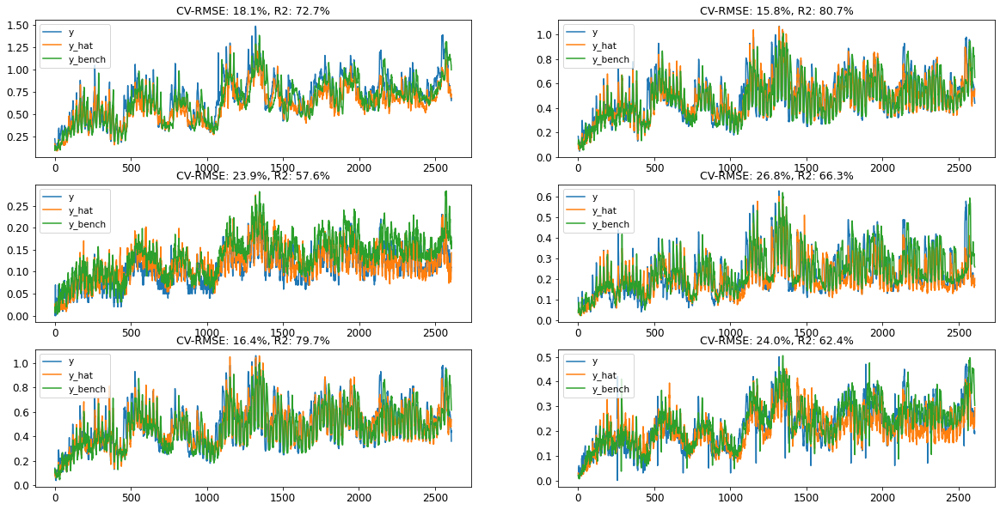

In [ ]:
n = 6
# dim(results) == n_met x t_series_len X (y, y_hat)
results = np.empty((n,0,2))

fig, ax = plt.subplots(figsize=(20,10), nrows=int(n/2), ncols=2)
ax = ax.flatten()
import matplotlib
font = {'size':10.5}
matplotlib.rc('font', **font)

# loop over n randomly chosen meters
for i, met in enumerate(np.random.choice(heat_test['MeterID'].unique(), size=n, replace=False)):

  # boolean sequence specifying the chosen meter
  met_rows = heat_test['MeterID'] == met
  X = heat_test.loc[met_rows].drop(columns=['ObjectID','MeterID', 'cons'])
  # correct consumption values of the meter
  y = heat_test.loc[met_rows]['cons'].values
  # predicted
  y_hat = heat_booster.predict(X)
  # benchmark
  X = heat_test.loc[met_rows, ['lag_25H', 'Temperature']].fillna(method='ffill').to_numpy()
  X = sm.add_constant(X)
  bench_y_hat = heat_reg.predict(X)

  ax[i].plot(y);
  ax[i].plot(y_hat);
  ax[i].plot(bench_y_hat);
  ax[i].set_title('CV-RMSE: {:.1%}, R2: {:.1%}'.format(CV_RMSE(y_hat, y), r2_score(y, y_hat)));
  ax[i].legend(['y', 'y_hat', 'y_bench'])

In [ ]:
!pip install shap
import shap

In [ ]:
shap_sample_data = heat_test_X.sample(int(1e3)) # assess over sample to reduce compute time

In [ ]:
shap_values = shap.TreeExplainer(heat_booster).shap_values(shap_sample_data)

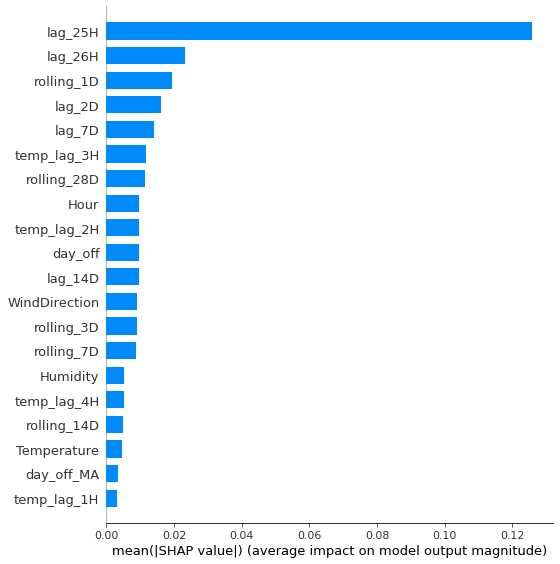

In [ ]:
shap.summary_plot(shap_values, shap_sample_data, plot_type="bar")

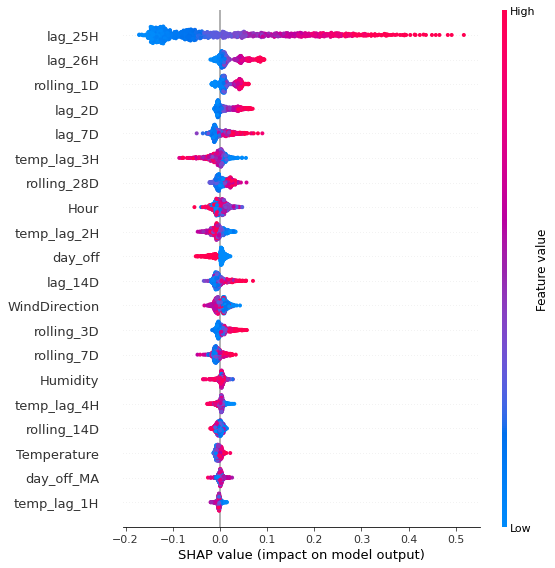

In [ ]:
shap.summary_plot(shap_values, shap_sample_data)

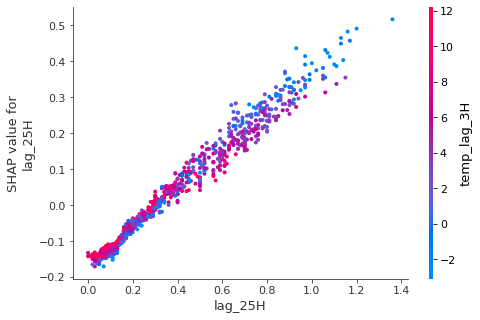

In [ ]:
shap.dependence_plot("lag_25H", shap_values, shap_sample_data)

3.4 Electricity: Hyperparameter tuning

In [ ]:
# training-testing split
split = 0.8 
elec_train = elec.iloc[:int(len(elec) * split),:]
elec_test = elec.iloc[int(len(elec) * split):,:]

In [ ]:
if optimize_parameters: 
  # hyperparameter tuning with optuna
  % pip install optuna

In [ ]:
%%time
if optimize_parameters:
  import optuna
  from sklearn.metrics import mean_squared_error
  from sklearn.model_selection import TimeSeriesSplit


  def objective(trial):

    parameters = {
        'application': 'regression',
        'objective': 'rmse',
        'metric': 'rmse',
        'boosting': 'gbdt',
        'num_leaves': trial.suggest_int('num_leaves', 2, 500),
        # 'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0),
        # 'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0),
        # 'bagging_freq': trial.suggest_int('bagging_freq', 1, 50),
        'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1)
        # 'lambda_l1': trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
        # 'lambda_l2': trial.suggest_loguniform('lambda_l2', 1e-8, 10.0)
    }

    elec_errors = []

    # k-fold training and evaluation
    for split in TimeSeriesSplit().split(elec_train):

      # train-test split
      X = elec_train.iloc[split[0]].drop(columns=['ObjectID', 'MeterID', 'cons'])
      y = elec_train.iloc[split[0]]['cons']
      train_data = lgbm.Dataset(X, y)

      # training
      elec_booster = lgbm.train(parameters, train_data,
                          #valid_sets=test_data,
                          num_boost_round=1000,
                          #early_stopping_rounds=100
                          )
      
      # test data
      X = elec_train.iloc[split[1]].drop(columns=['ObjectID', 'MeterID', 'cons'])
      # predicted values
      y_hat = elec_booster.predict(X)

      # test error
      y = elec_train.iloc[split[1]]['cons']  # correct consumption values
      elec_errors.append(CV_RMSE(y_hat, y))
      
    # return error to minimise
    return np.mean(elec_errors)

  study = optuna.create_study(direction='minimize')
  study.optimize(objective, n_trials=30)


CPU times: user 5 µs, sys: 0 ns, total: 5 µs
Wall time: 7.39 µs


3.5 Electricity: Model training

In [ ]:
from sklearn.model_selection import TimeSeriesSplit

# model specification
parameters = {
    'verbose':2,
    'is_training_metric': True,  # output metric over train set
    'application': 'regression',
    'objective': 'rmse',
    'metric': 'rmse',
    'boosting': 'gbdt',
    #'bagging_fraction': 0.92,
    #'bagging_freq': 35,
    #'feature_fraction': 0.67,
    'learning_rate': 0.01, 
    'num_leaves': 114
}

# prepare train data
X = elec_train.drop(columns=['ObjectID', 'MeterID', 'cons'])
y = elec_train['cons']
train_data = lgbm.Dataset(X, y)

# training
elec_booster = lgbm.train(parameters, train_data,
                    #valid_sets=test_data,
                    num_boost_round=1000,
                    #early_stopping_rounds=100
                    )


3.6 Electricity: Model evaluation

In [ ]:
from sklearn.metrics import r2_score

# total error over entire test set
all_errors = pd.DataFrame()
elec_test_X = elec_test.drop(columns=['ObjectID', 'MeterID', 'cons'])
y = elec_test['cons']
y_hat = elec_booster.predict(elec_test_X)
all_errors['total_CVRMSE'] = CV_RMSE(y_hat, y)
all_errors['total_r2'] = r2_score(y, y_hat)
all_errors['CV_MSE'] = CV_MSE(y_hat, y)
elec_residuals = y - y_hat

print('Total error over test set is {:.2%}'.format(all_errors['total_CVRMSE']))
print('Pseudo CV MS error over test set is {:.2%}'.format(all_errors['CV_MSE']))
print('R2 goodness of fit over test set is {:.2%}'.format(all_errors['total_r2']))

Total error over test set is 19.29%
Pseudo CV MS error over test set is 3.72%
R2 goodness of fit over test set is 97.62%


Benchmark: Linear Regression

In [ ]:
import statsmodels.api as sm

# nulls (in temperature) need to be cleaned up for linear regression
X = elec_train[['lag_25H', 'Temperature']].fillna(method='ffill').to_numpy()
X = sm.add_constant(X)
y = elec_train['cons'].to_numpy()

# model creation and fitting
elec_reg = sm.OLS(y, X)
elec_reg = elec_reg.fit()  # the trained model instance

elec_reg.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.894
Model:                            OLS   Adj. R-squared:                  0.894
Method:                 Least Squares   F-statistic:                 1.845e+06
Date:                Tue, 08 Sep 2020   Prob (F-statistic):               0.00
Time:                        14:49:01   Log-Likelihood:            -2.3335e+06
No. Observations:              438868   AIC:                         4.667e+06
Df Residuals:                  438865   BIC:                         4.667e+06
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          6.3053      0.110     57.388      0.000       6.090       6.521
x1             0.9459      0.000   1916.480      0.000       0.945       0.947
x2             0.0653      0.007      8.724      0.000       0.051       0.080
==============================================================================
Omnibus:                   278684.843   Durbin-Watson:                   1.244
Prob(Omnibus):                  0.000   Jarque-Bera (JB):         42339641.547
Skew:                           2.083   Prob(JB):                         0.00
Kurtosis:                      50.938   Cond. No.                         288.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [ ]:
X = elec_test[['lag_25H', 'Temperature']].fillna(method='ffill').to_numpy()
X = sm.add_constant(X)
y = elec_test['cons']

bench_y_hat = elec_reg.predict(X)

print('Total error over test set is {:.2%}'.format(CV_RMSE(bench_y_hat, y)))
print('R2 goodness of fit over test set is {:.2%}'.format(r2_score(y, bench_y_hat)))

Total error over test set is 40.19%
R2 goodness of fit over test set is 89.68%


[(-49.95, 1200.0)]

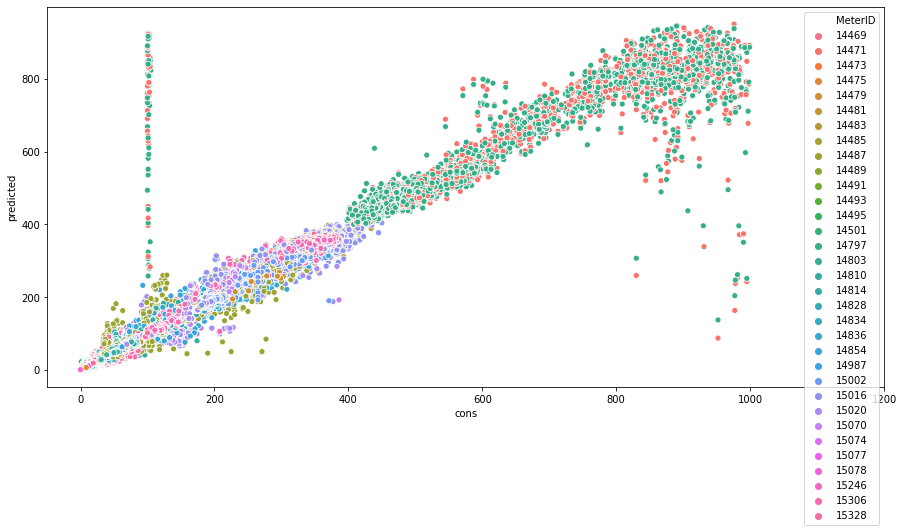

In [ ]:
plt.figure(figsize=(15,7))
pic = sns.scatterplot(y, y_hat, elec_test['MeterID'])
pic.set(ylabel="predicted")
pic.set(xlim=(None, 1200))

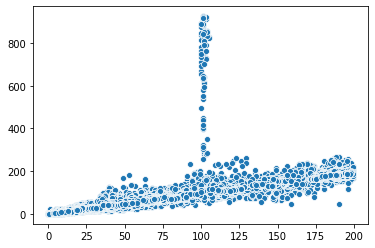

In [ ]:
x = np.array([y.to_numpy(), y_hat])
zoom = [0, 200]
sns.scatterplot(x[0][(x[0] > zoom[0]) & (x[0] < zoom[1])], x[1][(x[0] > zoom[0]) & (x[0] < zoom[1])])

In [ ]:
# not many values form the spike
print(y.shape)
sum((y_hat/y > 2) & (y < 110) & (y > 90))

(109718,)


82

In [ ]:
elec_residuals.describe()

count    109718.000000
mean          0.869942
std          24.182746
min        -824.267665
25%          -2.469306
50%           0.109447
75%           3.284290
max         864.233997
Name: cons, dtype: float64

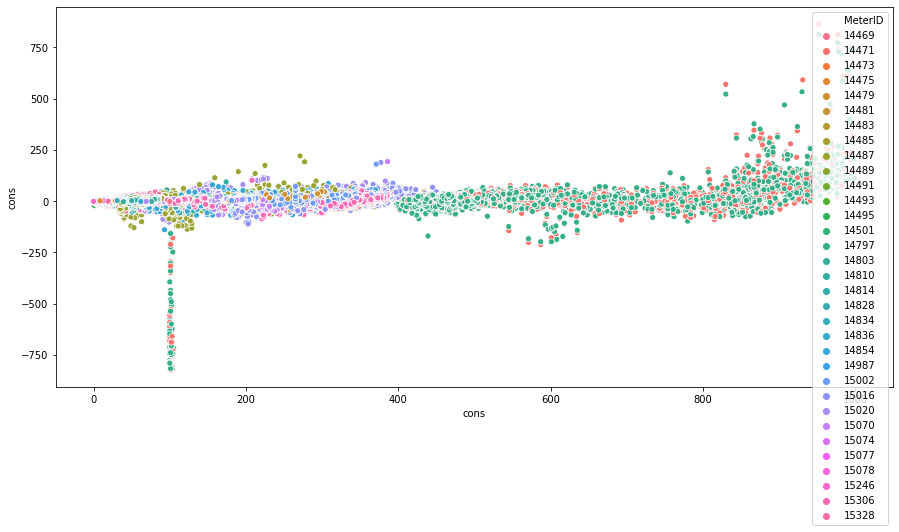

In [ ]:
plt.figure(figsize=(15,7))
sns.scatterplot(y, elec_residuals, elec_test['MeterID'])

[Text(0.5, 0, 'cons')]

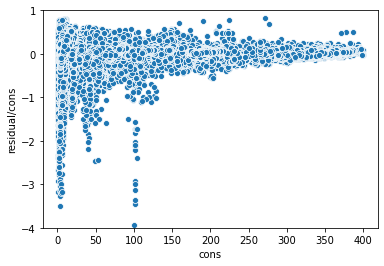

In [ ]:
x = np.array([y.to_numpy(), elec_residuals/y])
zoom = [1, 400]
pic = sns.scatterplot(x[0][(x[0] > zoom[0]) & (x[0] < zoom[1])], x[1][(x[0] > zoom[0]) & (x[0] < zoom[1])])
pic.set(ylim=(-4, 1))
pic.set(ylabel='residual/cons')
pic.set(xlabel='cons')

(-30.0, 30.0)

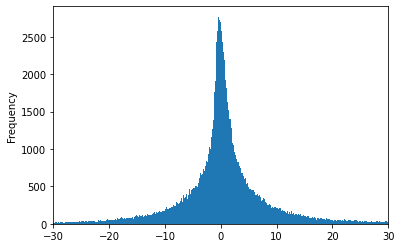

In [ ]:
elec_residuals.plot.hist(bins=10000)
plt.xlim((-30, 30))

In [ ]:
import scipy
print(scipy.stats.normaltest(elec_residuals))
print(scipy.stats.shapiro(elec_residuals))

NormaltestResult(statistic=151899.49338477192, pvalue=0.0)
(0.30784571170806885, 0.0)


p-value may not be accurate for N > 5000.


([<matplotlib.axis.XTick at 0x7f8ab225b5c0>,
 [Text(0, 0, '2019-08-13'),
  Text(0, 0, '2019-09-17'),
  Text(0, 0, '2019-10-21'),
  Text(0, 0, '2019-11-25'),
  Text(0, 0, '2019-12-30')])

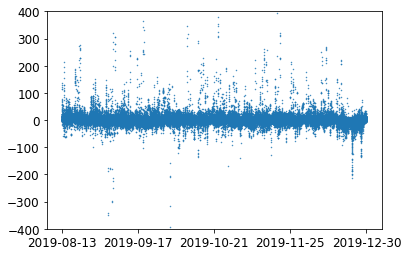

In [ ]:
font = {'size':12}
matplotlib.rc('font', **font)

plt.scatter(elec_residuals.index, elec_residuals, s=0.2)
plt.ylim((-400, 400))

# ticks 
res_len = elec_residuals.shape[0]
n_ticks = 4
tick_places = [elec_residuals.index[i] for i in range(0, res_len, int(res_len/n_ticks)+1)]
tick_places.append(elec_residuals.index[-1])
tick_labels = [elec_residuals.index[i].date() for i in range(0, res_len, int(res_len/n_ticks)+1)]
tick_labels.append(elec_residuals.index[-1].date())
plt.xticks(tick_places, tick_labels)

In [ ]:
# largest errors
elec_residuals.nlargest(20)

Time
2019-10-02 15:00:00    864.233997
2019-10-02 16:00:00    814.350056
2019-10-02 14:00:00    813.248976
2019-10-02 15:00:00    772.672374
2019-09-03 13:00:00    751.896412
2019-09-03 14:00:00    743.217053
2019-10-02 13:00:00    739.917520
2019-10-02 14:00:00    730.958259
2019-09-03 14:00:00    728.798313
2019-09-03 15:00:00    719.000161
2019-10-02 13:00:00    638.949940
2019-10-02 12:00:00    615.819554
2019-10-02 11:00:00    612.092549
2019-10-01 15:00:00    592.043431
2019-10-02 12:00:00    586.801122
2019-11-20 15:00:00    570.246610
2019-10-01 16:00:00    533.668886
2019-11-20 16:00:00    522.741911
2019-10-02 11:00:00    471.588020
2019-10-27 03:00:00    469.454490
Name: cons, dtype: float64

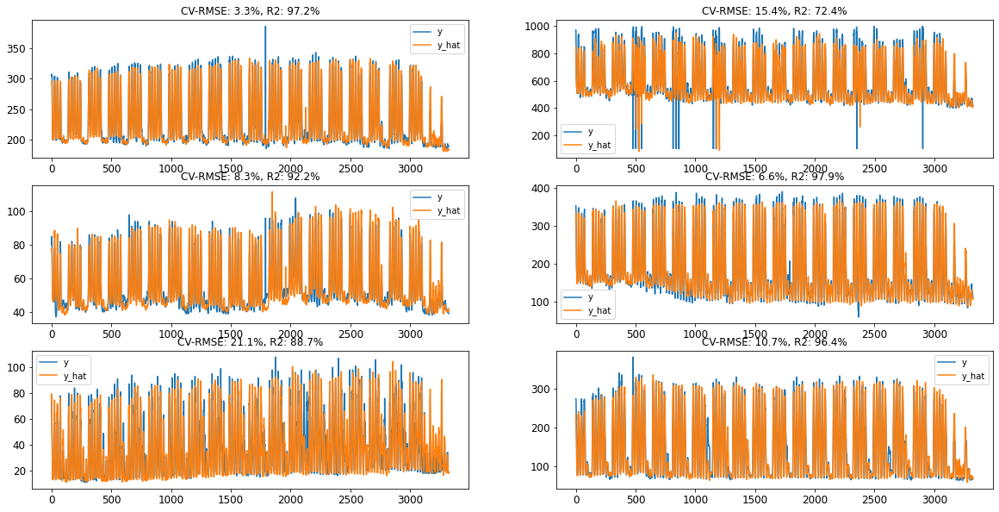

In [ ]:
n = 6
# dim(results) == n_met x t_series_len X (y, y_hat)
results = np.empty((n,0,2))

fig, ax = plt.subplots(figsize=(20,10), nrows=int(n/2), ncols=2)
ax = ax.flatten()
import matplotlib
font = {'size':10}
matplotlib.rc('font', **font)

# loop over n randomly chosen meters
for i, met in enumerate(np.random.choice(elec_test['MeterID'].unique(), size=n, replace=False)):

  # boolean sequence specifying the chosen meter
  met_rows = elec_test['MeterID'] == met
  X = elec_test.loc[met_rows].drop(columns=['ObjectID','MeterID', 'cons'])
  # correct consumption values of the meter
  y = elec_test.loc[met_rows]['cons'].values
  # predicted
  y_hat = elec_booster.predict(X)

  ax[i].plot(y);
  ax[i].plot(y_hat);
  ax[i].set_title('CV-RMSE: {:.1%}, R2: {:.1%}'.format(CV_RMSE(y_hat, y), r2_score(y, y_hat)));
  ax[i].legend(['y', 'y_hat'])

In [ ]:
shap_sample_data = elec_test_X.sample(int(1e3)) # enempi parempi mutta on aika hidasta

In [ ]:
shap_values = shap.TreeExplainer(elec_booster).shap_values(shap_sample_data)

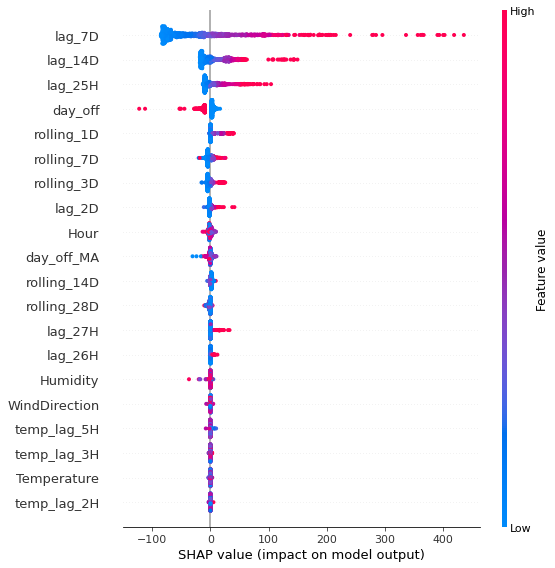

In [ ]:
shap.summary_plot(shap_values, shap_sample_data)